# Allan Hills GPR Proccessing
Liam Kirkpatrick
5/24/2024

Goal is to calculate layer dips in radar tracks near ALHIC2302 and ALHIC2201 for comparison with ECM data

## Import Packages

In [1]:
# general
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
import glob

# plotting
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 150
%matplotlib inline

# impdar
from impdar.lib import load
from impdar.lib.plot import plot_traces, plot_radargram
from impdar.lib.gpslib import interp

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


## Load and plot GPS data

Here I load gps data for all relevant tracks

In [2]:
#load data
gps_files = glob.glob('gps_csv/*.csv')
gps_data = []
tracks = [2,4,7]
for f in gps_files:
    gps_data.append(pd.read_csv(f))

In [3]:
# set core locations
cores = ['ALHIC1901','ALHIC1902','ALHIC2201','AHIC2302']
coords = {'ALHIC1901':[-76.73237599,159.356125],
          'ALHIC1902':[-76.74535696,159.374108],
          'ALHIC2201':[-76.73202697,159.359551],
          'AHIC2302':[-76.74543198,159.375134]}

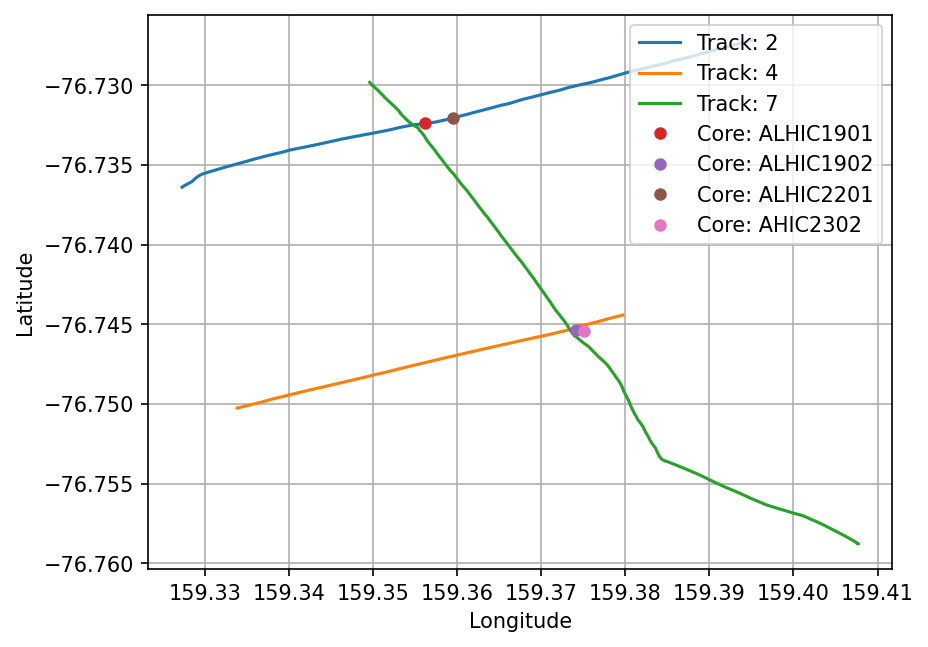

In [4]:
# plot data
%matplotlib inline
fig,axs = plt.subplots()
axs.set_xlabel('Longitude')
axs.set_ylabel('Latitude')
track_cnt = 0
for df in gps_data:
    axs.plot(df['longitude'],df['latitude'],label='Track: '+str(tracks[track_cnt]))
    track_cnt+=1
for c in cores:
    axs.plot(coords[c][1],coords[c][0],'.',markersize=10,label='Core: '+c)
axs.legend(loc='upper right')
axs.grid()


## Load GPR Data

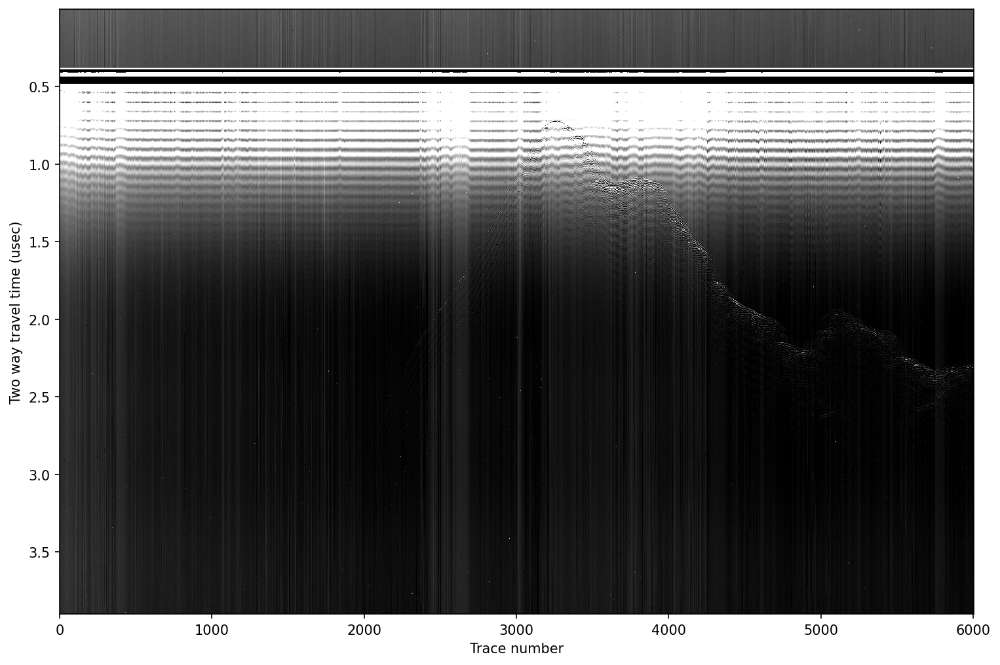

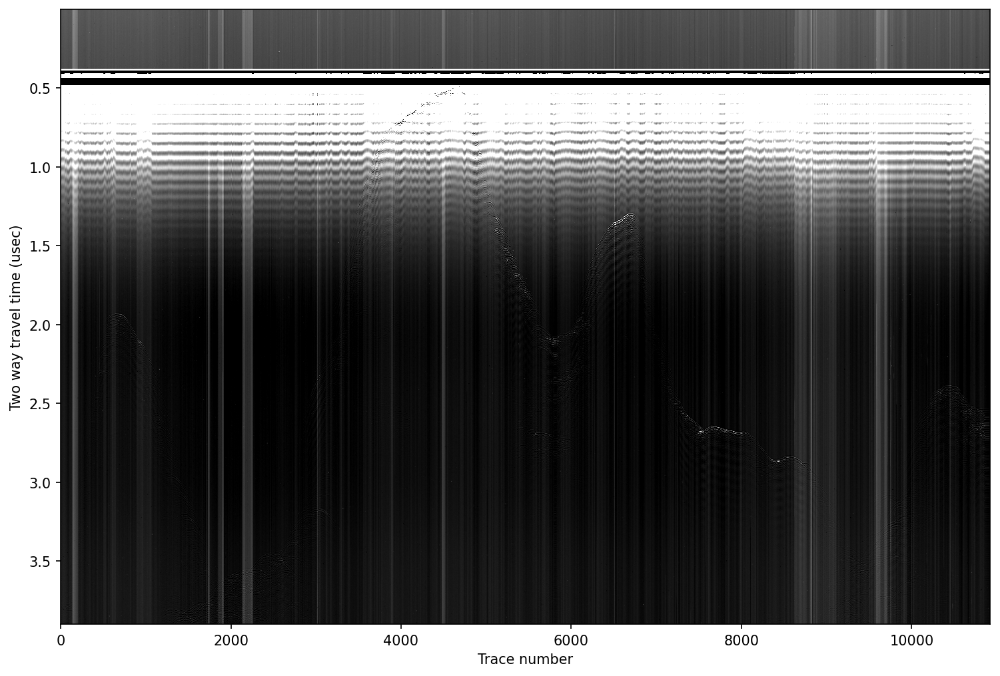

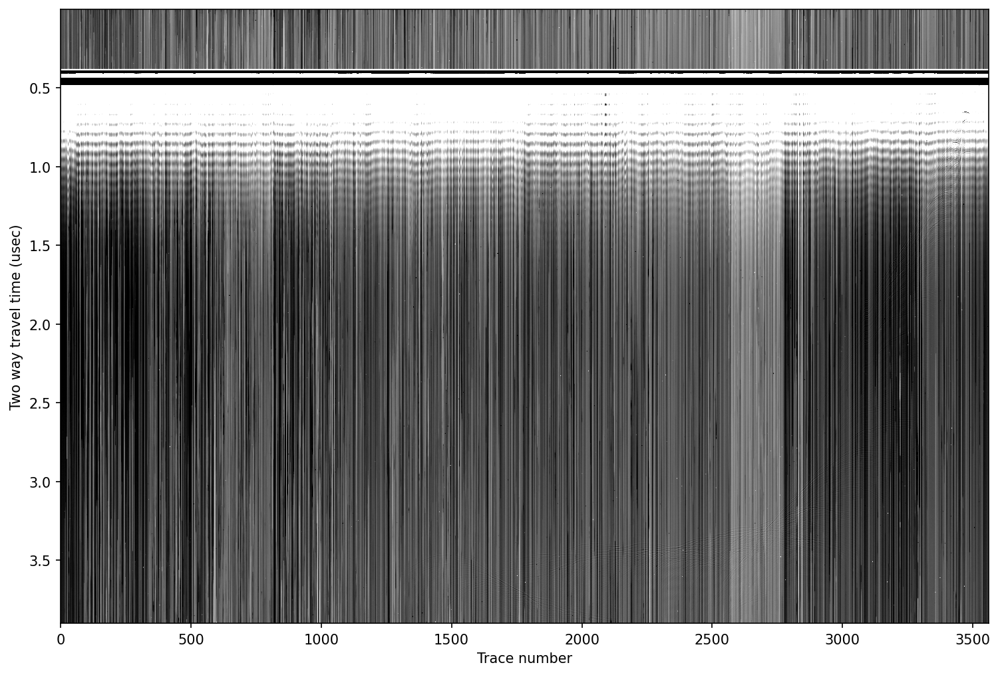

In [5]:
files = glob.glob('data/*.DZT')
data = []
for f in files:
    data.append(load.load_gssi.load_gssi(f))

for dat in data:
    %matplotlib inline
    plot_radargram(dat)

## Vertical Band Pass

Bandpassing from 40.0 to 160.0 MHz...
Bandpass filter complete.
Bandpassing from 40.0 to 160.0 MHz...
Bandpass filter complete.
Bandpassing from 40.0 to 160.0 MHz...
Bandpass filter complete.


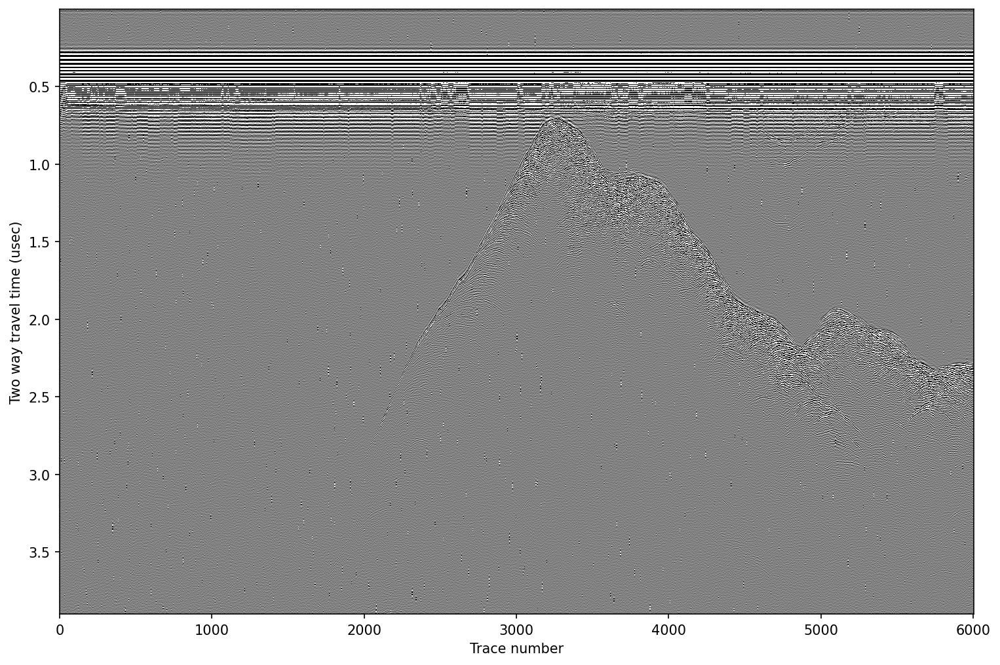

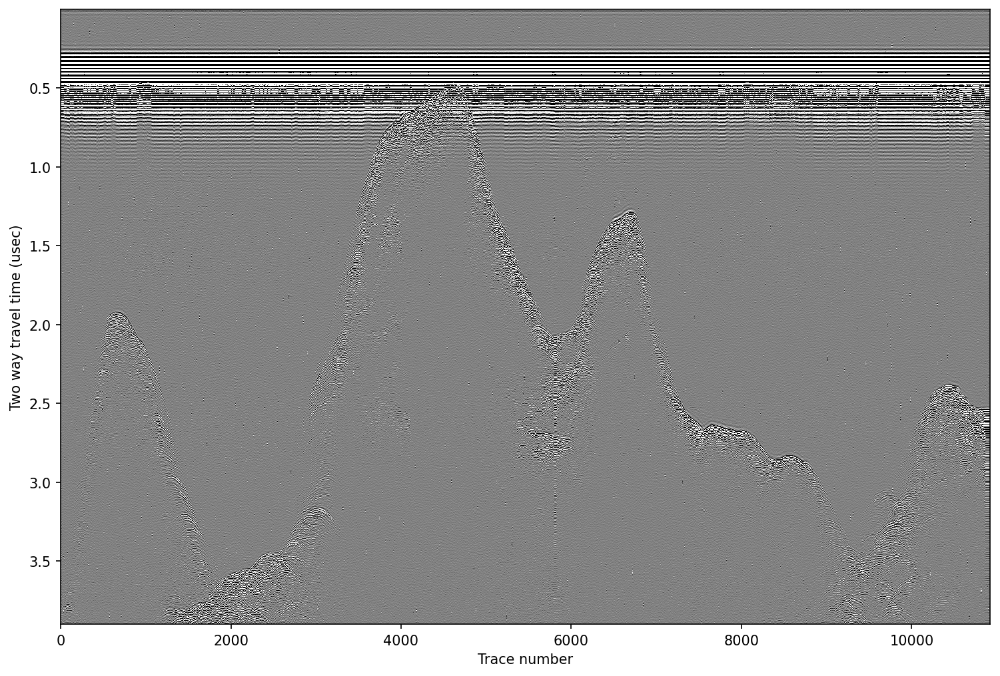

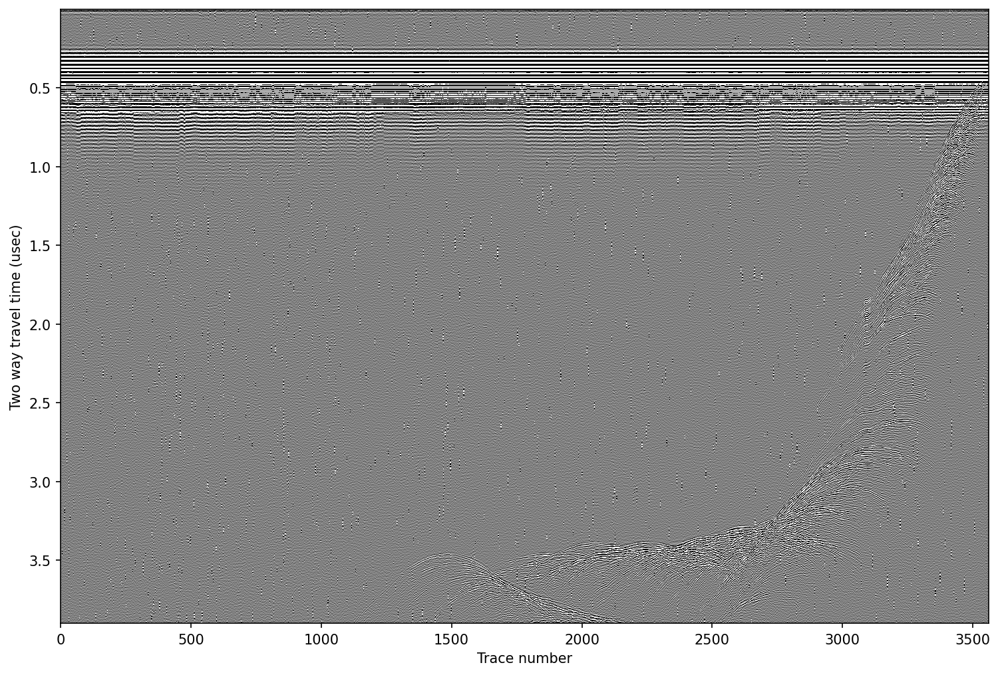

In [6]:
## Initial Proccessing
for dat in data:
    dat.vertical_band_pass(40,160)

for dat in data:
    %matplotlib inline
    plot_radargram(dat)


## Crop out pretrigger, interpolate

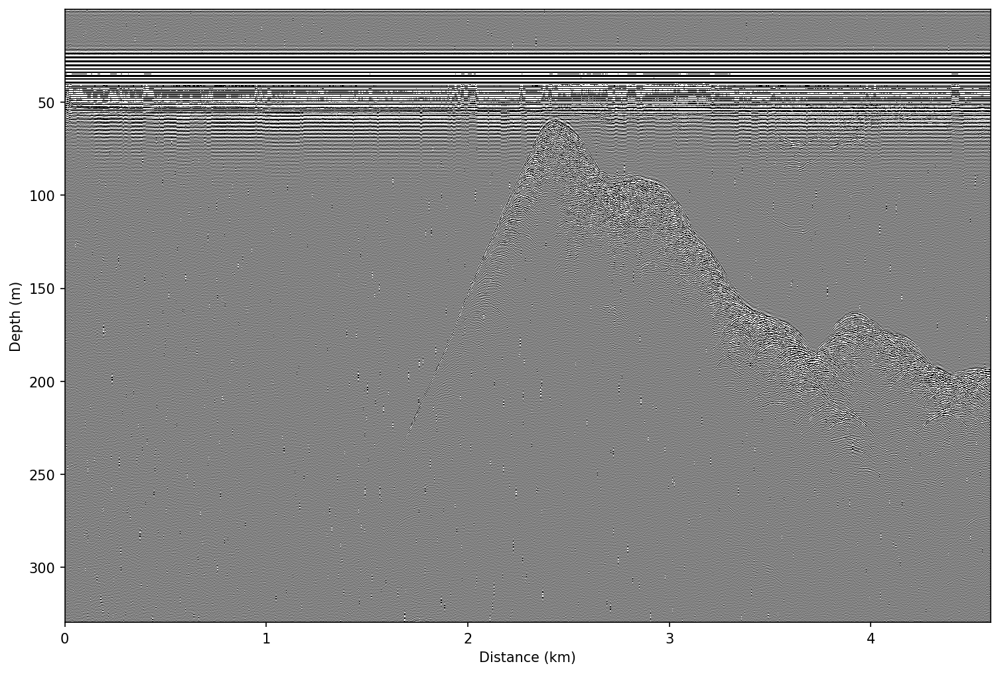

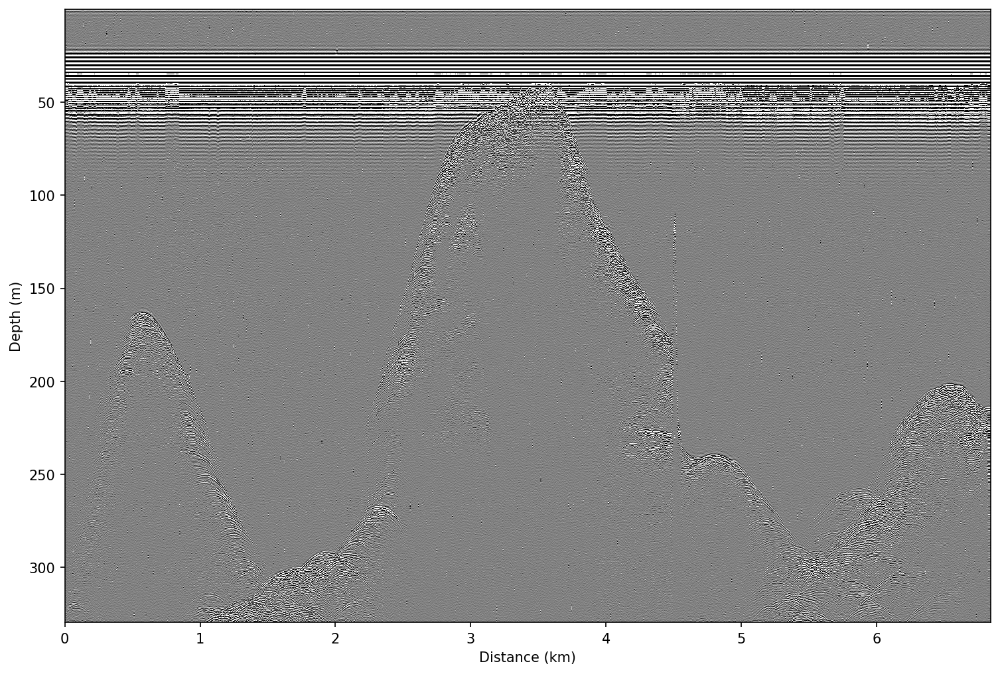

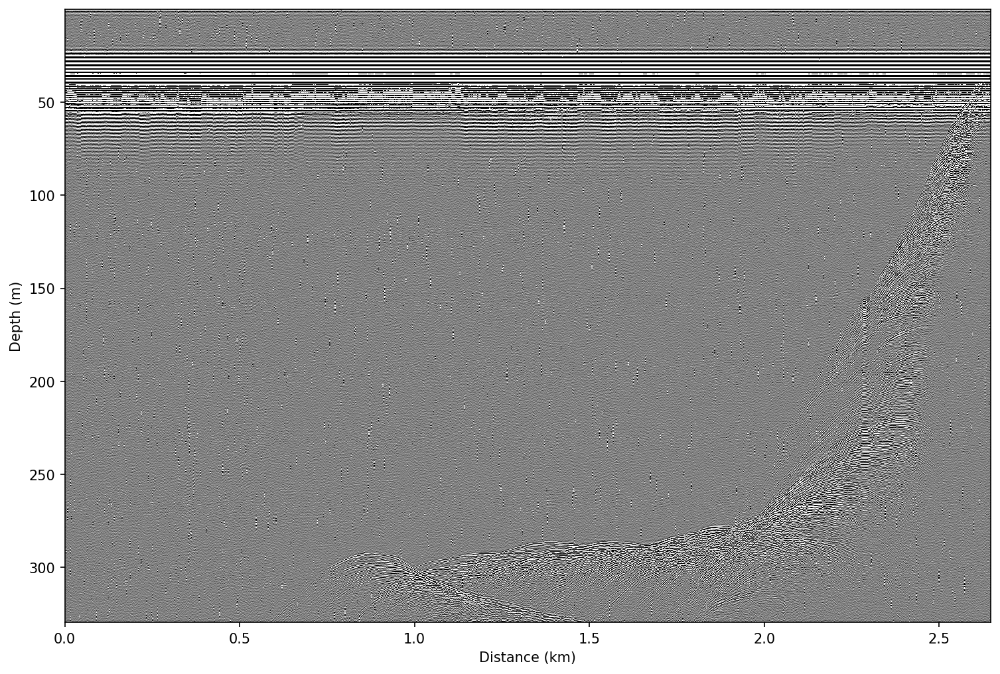

In [7]:
for dat in data:
    #dat.crop(0.,dimension='pretrig')
    interp([dat],1)
for dat in data:
    %matplotlib inline
    plot_radargram(dat,ydat='depth', xdat='dist')